<a href="https://colab.research.google.com/github/ZequanLIU/netpyne/blob/development/synapse_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install allensdk

In [ ]:
!git clone https://github.com/AllenInstitute/aisynphys.git
!pip install ./aisynphys

Cloning into 'aisynphys'...
remote: Enumerating objects: 16135, done.
remote: Counting objects: 100% (2890/2890), done.
remote: Compressing objects: 100% (466/466), done.
remote: Total 16135 (delta 2485), reused 2781 (delta 2423), pack-reused 13245
Receiving objects: 100% (16135/16135), 58.39 MiB | 15.85 MiB/s, done.
Resolving deltas: 100% (12109/12109), done.
Processing ./aisynphys
  Preparing metadata (setup.py) ... done
  Created wheel for aisynphys: filename=aisynphys-0.0.1-py3-none-any.whl size=351969 sha256=5977d6721977eec65785703ec9db5fc689ffb0aa93795045a7e8eefad955f533
  Stored in directory: /tmp/pip-ephem-wheel-cache-idl86z_g/wheels/ba/b2/e6/ce02b6da03f598473fe1693d089add956d2ac46854fa99c14a
Successfully built aisynphys


In [ ]:
!git clone https://github.com/AllenInstitute/neuroanalysis.git
!pip install ./neuroanalysis

Cloning into 'neuroanalysis'...
remote: Enumerating objects: 2492, done.
remote: Counting objects: 100% (277/277), done.
remote: Compressing objects: 100% (140/140), done.
remote: Total 2492 (delta 159), reused 224 (delta 136), pack-reused 2215
Receiving objects: 100% (2492/2492), 2.04 MiB | 13.54 MiB/s, done.
Resolving deltas: 100% (1734/1734), done.
Processing ./neuroanalysis
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.9/105.9 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.9/57.9 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 10.8 MB/s eta 0:00:00
  Created wheel for neuroanalysis: filename=neuroanalysis-0.0.2-py3-none-any.whl size=116893 sha256=660afb3ff0173ed2e692e4278b44b35e2ef9cee82b7ca672c9d214b93c692355
  Stored in directory: /tmp/pip-ephem-wheel-cache-51g3kz5b/wheels/4a/dd/d3

In [ ]:
!git clone https://github.com/suny-downstate-medical-center/netpyne

Cloning into 'netpyne'...
remote: Enumerating objects: 29131, done.
remote: Counting objects: 100% (3212/3212), done.
remote: Compressing objects: 100% (847/847), done.
remote: Total 29131 (delta 2622), reused 2667 (delta 2362), pack-reused 25919
Receiving objects: 100% (29131/29131), 85.49 MiB | 19.83 MiB/s, done.
Resolving deltas: 100% (21151/21151), done.
Updating files: 100% (992/992), done.


In [ ]:
%cd netpyne/netpyne/tutorials/

/content/netpyne/netpyne/tutorials


In [ ]:
%ls

cells/                      tut02_position_based_conn.ipynb    tut09_batch_evolutionary.ipynb
docs/                       tut03_stimulation.ipynb            tut_batch_evol/
install_tuts.py             tut04_importing_cell_models.ipynb  tut_batch_grid/
install_tuts.sh             tut05_analysis_plotting.ipynb      tut_saving_loading/
mod/                        tut06_oscillation.ipynb            tut_voltage_and_rxd_movie/
README.md                   tut07_multiscale_network.ipynb
tut01_simple_network.ipynb  tut08_batch_grid.ipynb


In [ ]:
!pip install neuron
!pip install netpyne

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.0/15.0 MB 38.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 419.3/419.3 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.2/71.2 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.0/41.0 kB 5.3 MB/s eta 0:00:00


# Using the Allen Institute's synaptic physiology dataset, load cell pair data for specific brain regions (e.g., murine V1 visual cortex) and examine whether synaptic connections exist between these cell pairs

In [ ]:
import numpy as np
from aisynphys.database import SynphysDatabase # 用于与突触生理数据库进行交互
from aisynphys.cell_class import CellClass, classify_cells, classify_pairs # 导入用于细胞分类的类和函数
from aisynphys.connectivity import measure_connectivity, pair_was_probed

### 1. Load the data

First, load up the "small" database from release 1.0 and query all cell `pairs` for mouse projects.

In [ ]:
# Download and cache the sqlite file for the requested database
#   (for available versions, see SynphysDatabase.list_versions)
# 加载“小型”数据库的最新版本
db = SynphysDatabase.load_current('small')

# Load all cell pairs associated with mouse V1 projects
# 使用pair_query方法查询与鼠V1项目相关的所有细胞对。
# project_name参数指定项目名称，这里包括“mouse V1 coarse matrix”和“mouse V1 pre-production”。
# 调用all()方法获取查询结果的所有细胞对。
mouse_pairs = db.pair_query(project_name=["mouse V1 coarse matrix", "mouse V1 pre-production"]).all()

print("loaded %d cell pairs" % len(mouse_pairs))

  /root/ai_synphys_cache/database/synphys_r2.1_small.sqlite
  [####################]  100.00% (176.77 MB / 176.8 MB)  31.531 MB/s  0:00:00 remaining
  done.
loaded 83552 cell pairs


In [ ]:
# mouse_pairs 是一个包含多个 Pair 对象的列表。
# 每个 Pair 对象表示两个细胞之间的潜在突触连接
mouse_pairs[1]

<Pair 1494455788.030 1 3>

A single cell `pair` represents a _possible_ connection from one cell to another:

In [ ]:
# print some information about the last cell pair returned
# 查看单个细胞对的信息
pair = mouse_pairs[-1]
print("Cell pair:", pair)
print("  presynaptic subclass:", pair.pre_cell.cre_type)
print("  postsynaptic subclass:", pair.post_cell.cre_type)
print("  synaptic connection:", "yes" if pair.has_synapse else "no")

Cell pair: <Pair 1581111499.865 8 6>
  presynaptic subclass: vip
  postsynaptic subclass: sst
  synaptic connection: no


### Criteria for defining all cell classes to be compared

In [ ]:
cell_class_criteria = {
    'l23pyr': {'dendrite_type': 'spiny',       'cortical_layer': '2/3'},
    'l23pv':  {'cre_type': 'pvalb',            'cortical_layer': '2/3'},
    'l23sst': {'cre_type': 'sst',              'cortical_layer': '2/3'},
    'l23vip': {'cre_type': 'vip',              'cortical_layer': '2/3'},
    'l4pyr':  {'cre_type': ('nr5a1', 'rorb'),  'cortical_layer': '4'},
    'l4pv':   {'cre_type': 'pvalb',            'cortical_layer': '4'},
    'l4sst':  {'cre_type': 'sst',              'cortical_layer': '4'},
    'l4vip':  {'cre_type': 'vip',              'cortical_layer': '4'},
    'l5et':   {'cre_type': ('sim1', 'fam84b'), 'cortical_layer': '5'},
    'l5it':   {'cre_type': 'tlx3',             'cortical_layer': '5'},
    'l5pv':   {'cre_type': 'pvalb',            'cortical_layer': '5'},
    'l5sst':  {'cre_type': 'sst',              'cortical_layer': '5'},
    'l5vip':  {'cre_type': 'vip',              'cortical_layer': '5'},
    'l6pyr':  {'cre_type': 'ntsr1',            'cortical_layer': ('6a','6b')},
    'l6pv':   {'cre_type': 'pvalb',            'cortical_layer': ('6a','6b')},
    'l6sst':  {'cre_type': 'sst',              'cortical_layer': ('6a','6b')},
    'l6vip':  {'cre_type': 'vip',              'cortical_layer': ('6a','6b')},
}

Create a `CellClass` object to represent each cell class described above:

In [ ]:
cell_classes = {name:CellClass(name=name, **criteria) for name,criteria in cell_class_criteria.items()}

In [ ]:
cell_classes

{'l23pyr': <CellClass l23pyr>,
 'l23pv': <CellClass l23pv>,
 'l23sst': <CellClass l23sst>,
 'l23vip': <CellClass l23vip>,
 'l4pyr': <CellClass l4pyr>,
 'l4pv': <CellClass l4pv>,
 'l4sst': <CellClass l4sst>,
 'l4vip': <CellClass l4vip>,
 'l5et': <CellClass l5et>,
 'l5it': <CellClass l5it>,
 'l5pv': <CellClass l5pv>,
 'l5sst': <CellClass l5sst>,
 'l5vip': <CellClass l5vip>,
 'l6pyr': <CellClass l6pyr>,
 'l6pv': <CellClass l6pv>,
 'l6sst': <CellClass l6sst>,
 'l6vip': <CellClass l6vip>}

### Measuring the probability of connectivity between categories

In [ ]:
# Group all cells by selected classes
cell_groups = classify_cells(cell_classes.values(), pairs=mouse_pairs)

# Group pairs into (pre_class, post_class) groups
pair_groups = classify_pairs(mouse_pairs, cell_groups)

# analyze matrix elements
results = measure_connectivity(pair_groups, sigma=100e-6, dist_measure='lateral_distance')

/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:323: RuntimeWarning: Mean of empty slice.
  mean_cp = np.exp(-x_probed**2 / (2 * sigma**2)).mean()
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:329: RuntimeWarning: invalid value encountered in long_scalars
  est_pmax = (n_conn / n_test) / mean_cp
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:323: RuntimeWarning: Mean of empty slice.
  mean_cp = np.exp(-x_probed**2 / (2 * sigma**2)).mean()
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.10/dist-packages/aisynphys/connectivity.py:329: RuntimeWarning: invalid value encountered in long_scalars
  est_pmax = (n_conn / n_test) / mean_cp


All data have been loaded and connection probabilities have been calculated. For each (presynaptic_class, postsynaptic_class) combination, the resulting dictionary includes the number of hypothetical connections detected, the number of synapses found, and the probability of connection within a 95% confidence interval.

**The results for a single connection type look like:**

In [ ]:
# pick two arbitrary cell classes to display results from
pre_class = cell_classes['l23sst']
post_class = cell_classes['l23vip']

print("Connectivity results for %s => %s" % (pre_class, post_class))
print("  %d synapses found out of %d probed" % (
    results[pre_class, post_class]['n_connected'],
    results[pre_class, post_class]['n_probed'],
))
print("  %0.2f%% connection probability" % (
    results[pre_class, post_class]['connection_probability'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['connection_probability'][1] * 100,
    results[pre_class, post_class]['connection_probability'][2] * 100,
))
print("  %0.2f%% distance-adjusted connection probability" % (
    results[pre_class, post_class]['adjusted_connectivity'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['adjusted_connectivity'][1] * 100,
    results[pre_class, post_class]['adjusted_connectivity'][2] * 100,
))


Connectivity results for l23sst => l23vip
  25 synapses found out of 88 probed
  28.41% connection probability
     95% confidence interval: 19.30%-39.02%
  37.18% distance-adjusted connection probability
     95% confidence interval: 25.26%-51.07%


### 4. Display conectivity heat map

Now we want to take the entire set of results computed above (for all connection types) and display a heat map where the color represents the probability of connection.

To do this, we must first transform the results into 2D arrays of colors and labels, and then construct the heat map with a few calls to matplotlib. The function defined below

<ipython-input-17-84ea3cc7748f>:8: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('plasma')


ValueError: Input values must have shape (N x 1) or (1).

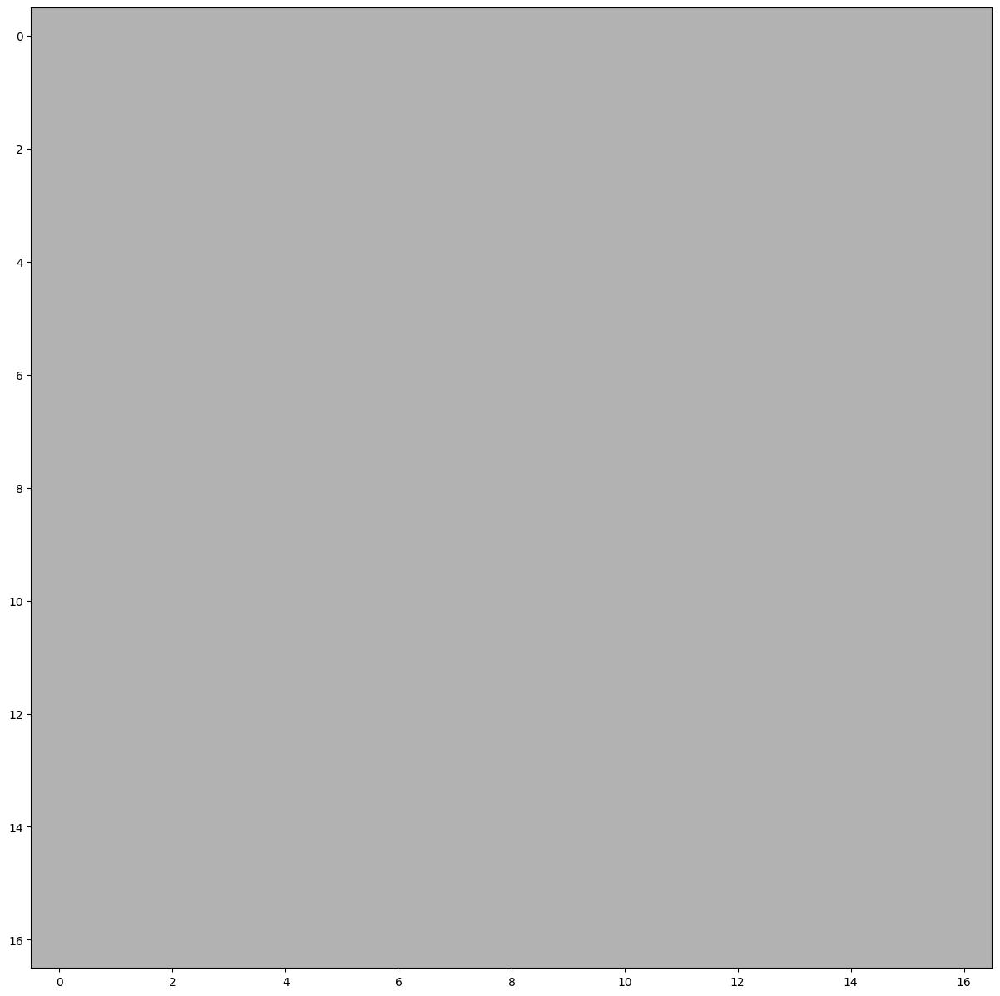

In [ ]:
import matplotlib.colors, matplotlib.cm # 颜色映射和标准化
import matplotlib.pyplot as plt
from aisynphys.ui.notebook import show_connectivity_matrix # 显示连接矩阵
%matplotlib inline

# define a colormap and log normalization used to color the heatmap
norm = matplotlib.colors.LogNorm(vmin=0.01, vmax=1.0, clip=True)
cmap = matplotlib.cm.get_cmap('plasma')

# define the display labels to use for each cell subclass:
class_labels = {
    'l23pyr': 'L2/3 Pyr\nspiny',
    'l23pv':  'L2/3 Pv',
    'l23sst': 'L2/3 Sst',
    'l23vip': 'L2/3 Vip',
    'l4pyr':  'L4 Pyr\n nr5a1',
    'l4pv':   'L4 Pv',
    'l4sst':  'L4 Sst',
    'l4vip':  'L4 Vip',
    'l5et':   'L5 Pyr ET\nsim1, fam84b',
    'l5it':   'L5 Pyr IT\ntlx3',
    'l5pv':   'L5 Pv',
    'l5sst':  'L5 Sst',
    'l5vip':  'L5 Vip',
    'l6pyr':  'L6 Pyr\nntsr1',
    'l6pv':   'L6 Pv',
    'l6sst':  'L6 Sst',
    'l6vip':  'L6 Vip',
}

# create a figure/axes to draw on
fig, ax = plt.subplots(figsize=(15, 15))

# finally, draw the colormap using the provided function:
im, cbar, labels = show_connectivity_matrix(
    ax=ax,
    results=results,
    pre_cell_classes=cell_classes.values(),
    post_cell_classes=cell_classes.values(),
    class_labels=class_labels,
    cmap=cmap,
    norm=norm,
    distance_adjusted=True
)

In [ ]:
# pick two arbitrary cell classes to display results from
pre_class = cell_classes['l5vip']
post_class = cell_classes['l23vip']
#post_class = cell_classes['l4pyr']

print("Connectivity results for %s => %s" % (pre_class, post_class))
print("  %d synapses found out of %d probed" % (
    results[pre_class, post_class]['n_connected'],
    results[pre_class, post_class]['n_probed'],
))
print("  %0.2f%% connection probability" % (
    results[pre_class, post_class]['connection_probability'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['connection_probability'][1] * 100,
    results[pre_class, post_class]['connection_probability'][2] * 100,
))
print("  %0.2f%% distance-adjusted connection probability" % (
    results[pre_class, post_class]['adjusted_connectivity'][0] * 100,
))
print("     95%% confidence interval: %0.2f%%-%0.2f%%" % (
    results[pre_class, post_class]['adjusted_connectivity'][1] * 100,
    results[pre_class, post_class]['adjusted_connectivity'][2] * 100,
))
d = [p.distance for p in results[pre_class, post_class]['probed_pairs']]
print(np.mean(d))

Connectivity results for l5vip => l23vip
  0 synapses found out of 24 probed
  0.00% connection probability
     95% confidence interval: 0.00%-14.25%
  0.00% distance-adjusted connection probability
     95% confidence interval: 0.00%-23.11%
0.0002952864697432556


In [ ]:
# optionally we can save the figure at this point
fig.savefig('mouse_connectivity_matrix.svg', format='svg')

It's important to remember that the measurements of connection probability shown above come with confidence intervals -- for example, L2/3 Sst cells were interconnected 4 times out of 112 probed (3.6%), but there is a range of possible connection rates that are statistically compatible with our results:

In [ ]:
l23sst = cell_classes['l23sst']
cp, ci_low, ci_high = results[l23sst, l23sst]['connection_probability']
print(ci_low, ci_high)

0.022396996556674466 0.09854374516814673


The 95% confidence intervals above suggest that the probability of connection between L2/3 Sst cells is likely to be in the range 1-9%. Keep this statistical uncertainty in mind when interpreting the results above, and use appropriate tests when making comparisons between groups.

# use netpyne

## Neuron groups
## Layer 2/3 -> Layer 4 -> Layer 5 -> Layer 6a 6b

Easy demo: only layer 2/3

In [ ]:
from netpyne import specs, sim
import numpy as np
from allensdk.core.cell_types_cache import CellTypesCache
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_cells, classify_pairs
from aisynphys.connectivity import measure_connectivity

# Setting the cache directory
ctc = CellTypesCache(manifest_file='manifest.json')

netParams = specs.NetParams()
simConfig = specs.SimConfig()

# Creating cell type
# ------------------

netParams.cellParams['pyr'] = {}
netParams.cellParams['pyr']['secs'] = {}

# soma
netParams.cellParams['pyr']['secs']['soma'] = {}
netParams.cellParams['pyr']['secs']['soma']['geom'] = {
    "diam": 12,
    "L": 12,
    "Ra": 100.0,
    "cm": 1
}

# hh mechanism of soma
netParams.cellParams['pyr']['secs']['soma']['mechs'] = {"hh": {
    "gnabar": 0.12,
    "gkbar": 0.036,
    "gl": 0.0003,
    "el": -54.3
}}

# Creating cell populations of 100 neurons each
# ----------------------------------
populations = ['l23pyr', 'l23pv', 'l23sst', 'l23vip']
for pop in populations:
    netParams.popParams[pop] = {
        "cellType": "pyr",
        "numCells": 100,
        "yRange": [0, 300]
    }

# synapses
# ------------------------------
netParams.synMechParams['exc'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": 0
}
netParams.synMechParams['inh'] = {
    "mod": "Exp2Syn",
    "tau1": 0.1,
    "tau2": 1.0,
    "e": -80
}

# Getting connection probabilities from the Allen Institute API and calculating them
# -----------------------
# Download and cache the requested sqlite file
db = SynphysDatabase.load_current('small')
mouse_pairs = db.pair_query(project_name=["mouse V1 coarse matrix", "mouse V1 pre-production"]).all()

# Defining cell class criteria
cell_class_criteria = {
    'l23pyr': {'dendrite_type': 'spiny',       'cortical_layer': '2/3'},
    'l23pv':  {'cre_type': 'pvalb',            'cortical_layer': '2/3'},
    'l23sst': {'cre_type': 'sst',              'cortical_layer': '2/3'},
    'l23vip': {'cre_type': 'vip',              'cortical_layer': '2/3'}
}

# Creating CellClass Objects
cell_classes = {name:CellClass(name=name, **criteria) for name,criteria in cell_class_criteria.items()}

# Grouping cells and cell pairs
cell_groups = classify_cells(cell_classes.values(), pairs=mouse_pairs)
pair_groups = classify_pairs(mouse_pairs, cell_groups)

# Measuring Connection Probability
results = measure_connectivity(pair_groups, sigma=100e-6, dist_measure='lateral_distance')

# Extracting and using connection probabilities
connection_probabilities = {}
for pre_class in cell_classes.values():
    for post_class in cell_classes.values():
        connection_probabilities[(pre_class.name, post_class.name)] = results[pre_class, post_class]['connection_probability'][0]

# Defining Connection Parameters
connectivity_info = []
for pre_pop in populations:
    for post_pop in populations:
        prob = connection_probabilities.get((pre_pop, post_pop), 0.1)
        synMech = "exc" if pre_pop == 'l23pyr' else "inh"
        conn_label = f'{pre_pop}->{post_pop}'
        netParams.connParams[conn_label] = {
            "preConds": {"pop": pre_pop},
            "postConds": {"pop": post_pop},
            "weight": 0.005,
            "probability": prob,
            "delay": 5.0,
            "synMech": synMech,
            "sec": "soma",
            "loc": 0.5,
        }
        connectivity_info.append(f'{conn_label} (probability: {prob:.2f}, synMech: {synMech})')

# print
for info in connectivity_info:
    print(info)

# simulation
# -----------------
netParams.stimSourceParams['bkg'] = {
    'type': 'NetStim',
    'rate': 10,  # 10 Hz
    'noise': 0.5
}

for pop in populations:
    netParams.stimTargetParams[f'bkg->{pop}'] = {
        'source': 'bkg',
        'conds': {'pop': pop},
        'weight': 0.01,
        'delay': 1,
        'sec': 'soma',
        'loc': 0.5
    }

# -----------------------------------

simConfig.filename = "netpyne_tut1"
simConfig.duration = 200.0
simConfig.dt = 0.1

# soma voltage
simConfig.recordTraces = {
    "V_soma": {
        "sec": "soma",
        "loc": 0.5,
        "var": "v",
    }
}

#
simConfig.analysis = {
    "plotTraces": {
        "include": ['all'],
        "saveFig": True,
        "overlay": True,
    },
    "plotRaster": {
        "saveFig": True,
        "marker": "o",
        "markerSize": 50,
    },
    "plotConn": {
        "saveFig": True,
        "feature": "weight",
        "groupby": "cell",
        "markerSize": 50,
    },
    "plot2Dnet": {
        "saveFig": True,
    },
}



l23pyr->l23pyr (probability: 0.06, synMech: exc)
l23pyr->l23pv (probability: 0.39, synMech: exc)
l23pyr->l23sst (probability: 0.31, synMech: exc)
l23pyr->l23vip (probability: 0.15, synMech: exc)
l23pv->l23pyr (probability: 0.32, synMech: inh)
l23pv->l23pv (probability: 0.38, synMech: inh)
l23pv->l23sst (probability: 0.10, synMech: inh)
l23pv->l23vip (probability: 0.00, synMech: inh)
l23sst->l23pyr (probability: 0.21, synMech: inh)
l23sst->l23pv (probability: 0.18, synMech: inh)
l23sst->l23sst (probability: 0.05, synMech: inh)
l23sst->l23vip (probability: 0.28, synMech: inh)
l23vip->l23pyr (probability: 0.04, synMech: inh)
l23vip->l23pv (probability: 0.02, synMech: inh)
l23vip->l23sst (probability: 0.13, synMech: inh)
l23vip->l23vip (probability: 0.01, synMech: inh)


Plotting connectivity matrix...


<Figure size 640x480 with 0 Axes>

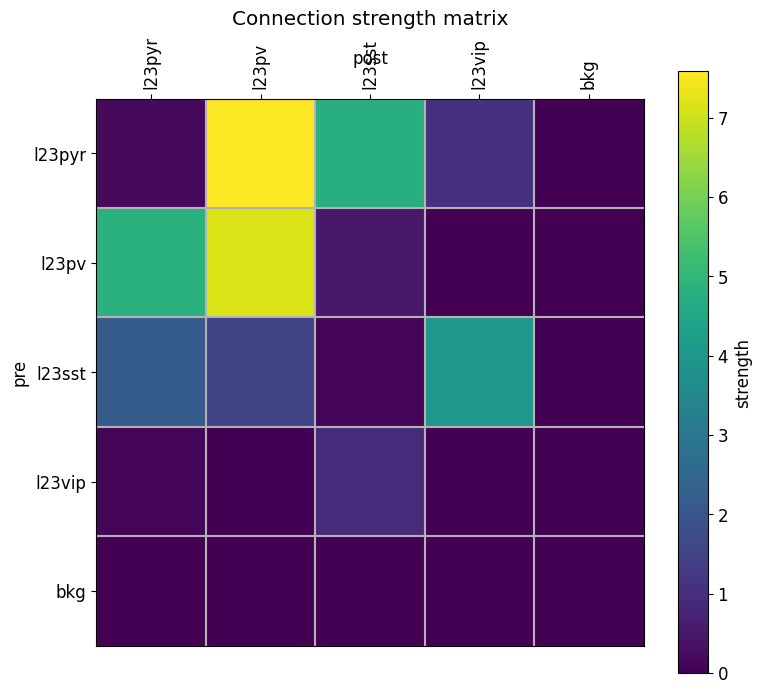

(<Figure size 800x800 with 2 Axes>,
 {'connMatrix': array([[ 1.8060050e-01,  7.5816180e+00,  4.7709605e+00,  1.0952000e+00,
          -0.0000000e+00],
         [ 4.8391605e+00,  7.1631125e+00,  5.2122050e-01,  0.0000000e+00,
          -0.0000000e+00],
         [ 2.2113045e+00,  1.5664500e+00,  1.2300800e-01,  4.0470125e+00,
          -0.0000000e+00],
         [ 9.2020500e-02,  1.7860500e-02,  9.4119200e-01,  5.5125000e-03,
          -0.0000000e+00],
         [ 1.0000000e-02,  1.0000000e-02,  1.0000000e-02,  1.0000000e-02,
           0.0000000e+00]]),
  'feature': 'strength',
  'groupBy': 'pop',
  'includePre': ['all'],
  'includePost': ['all']})

In [ ]:
#
plt.figure()
sim.analysis.plotConn()


Start time:  2024-06-25 20:59:26.901113

Creating network of 4 cell populations on 1 hosts...
  Number of cells on node 0: 400 
  Done; cell creation time = 0.05 s.
Making connections...
  Number of connections on node 0: 26290 
  Done; cell connection time = 4.74 s.
Adding stims...
  Number of stims on node 0: 400 
  Done; cell stims creation time = 0.09 s.
Recording 400 traces of 1 types on node 0

Running simulation using NEURON for 200.0 ms...
  Done; run time = 17.29 s; real-time ratio: 0.01.

Gathering data...
  Done; gather time = 0.93 s.

Analyzing...
  Cells: 400
  Connections: 26690 (66.72 per cell)
  Spikes: 4096 (51.20 Hz)
  Simulated time: 0.2 s; 1 workers
  Run time: 17.29 s
Plotting recorded cell traces ... cell


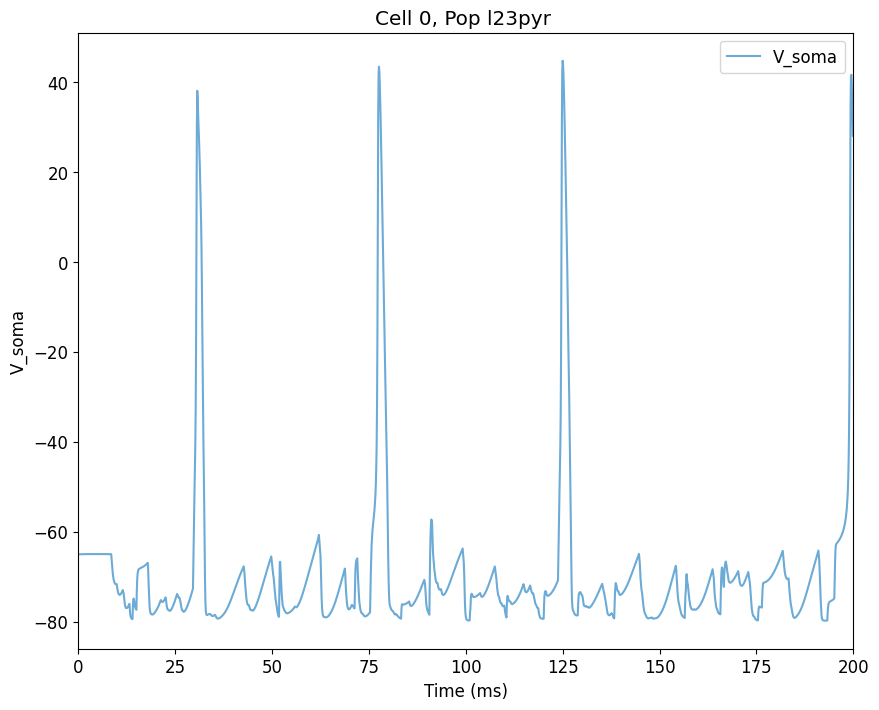

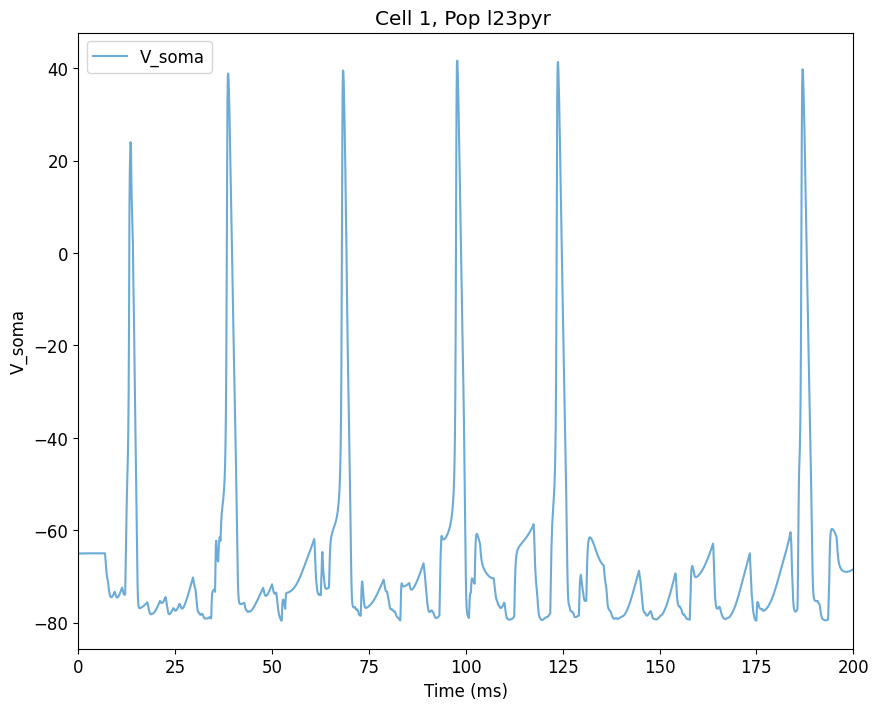

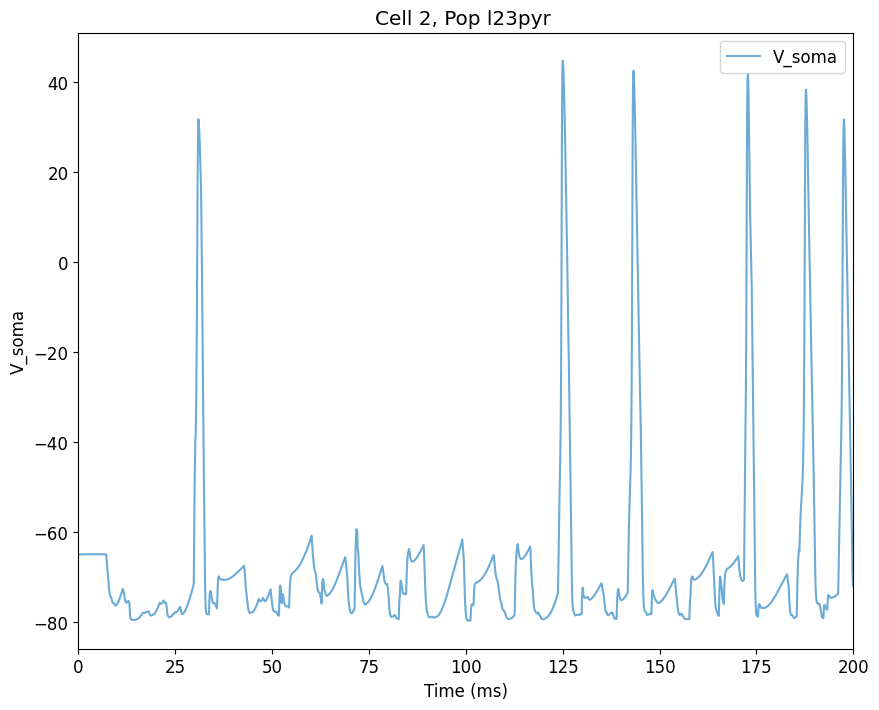

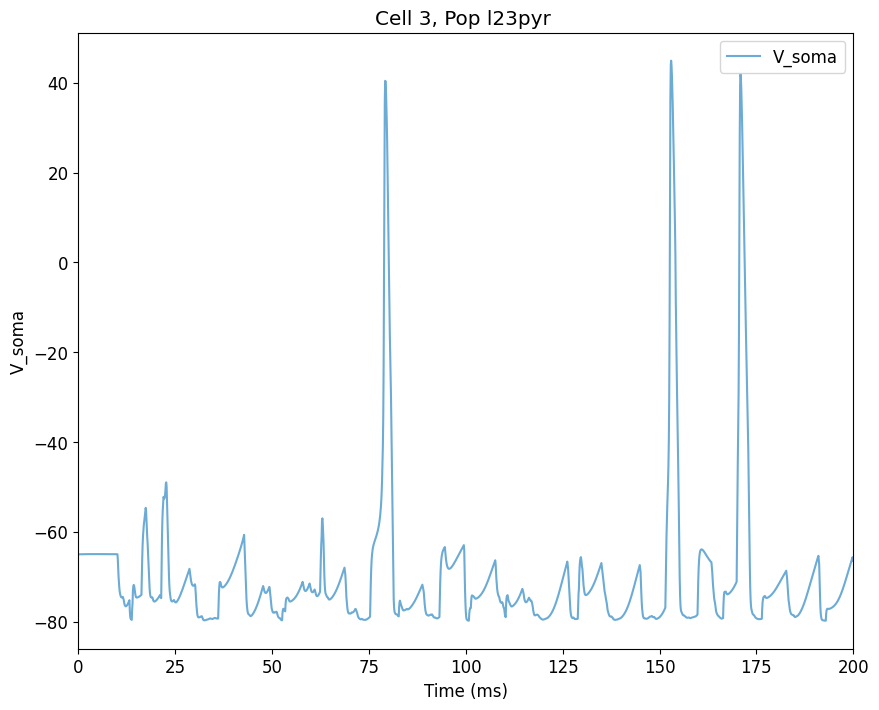

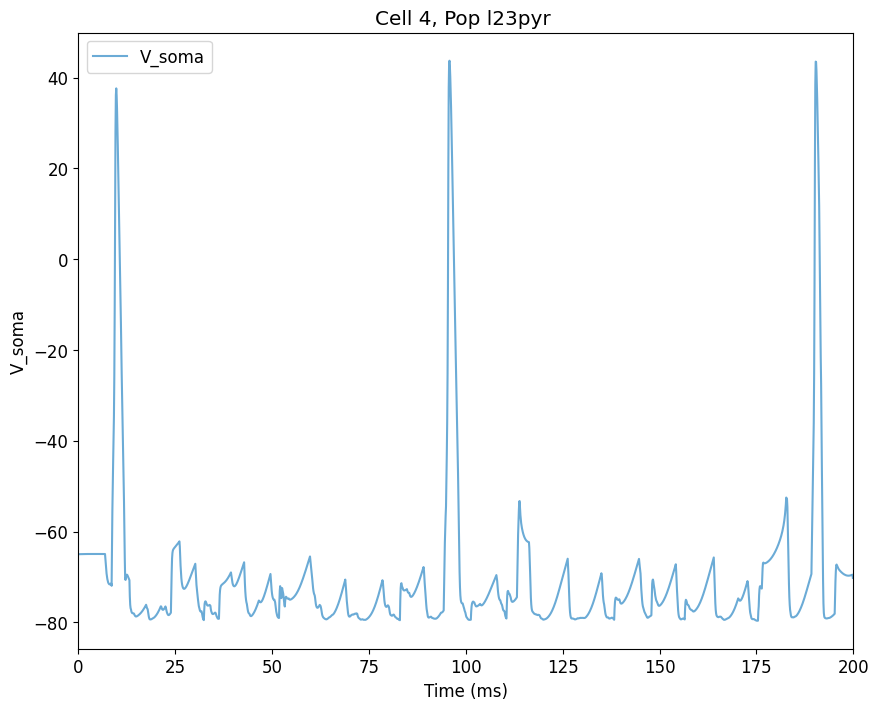

...

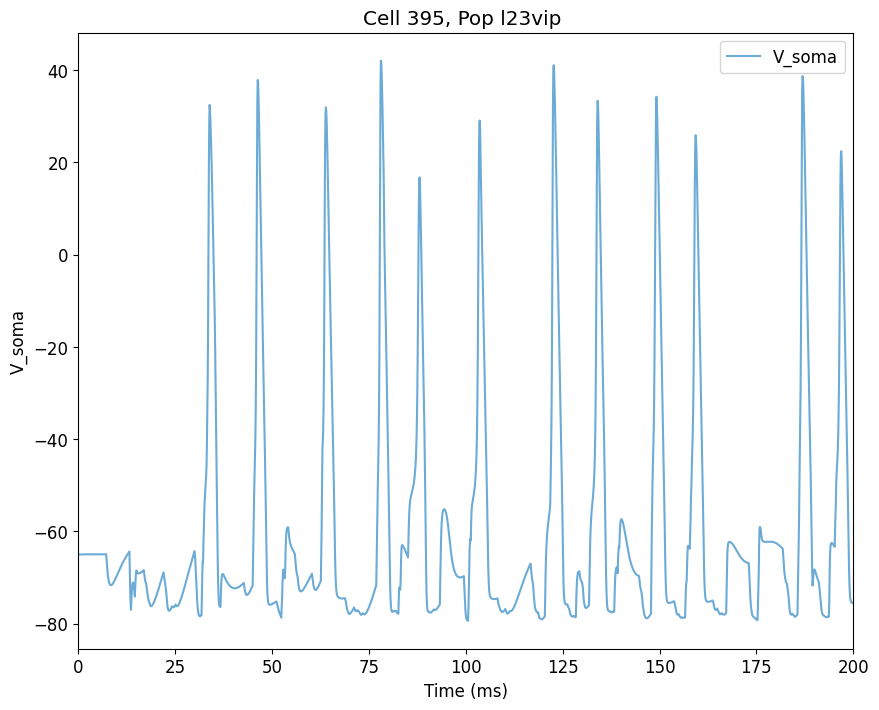

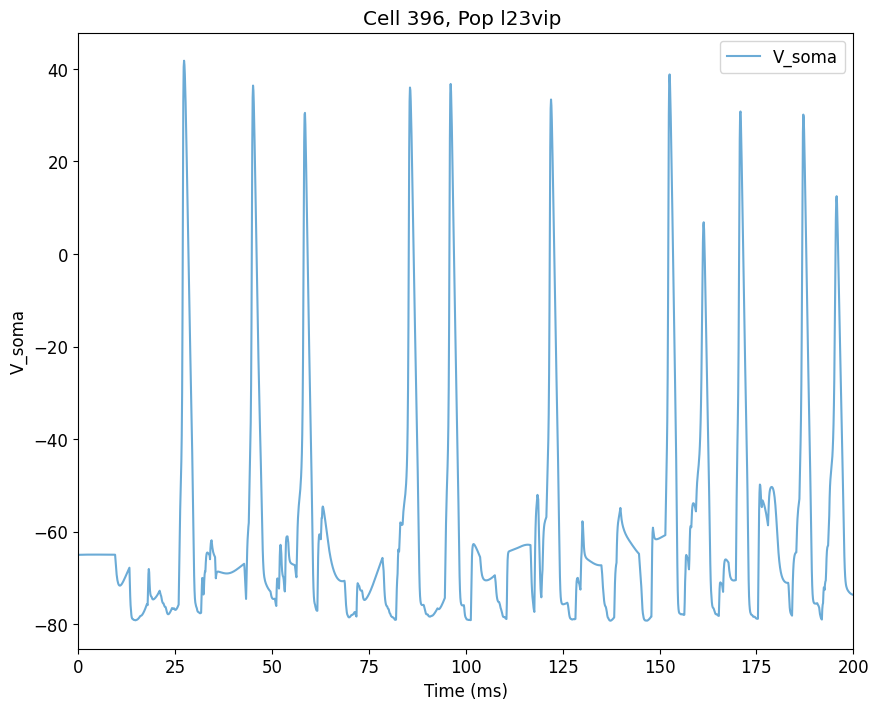

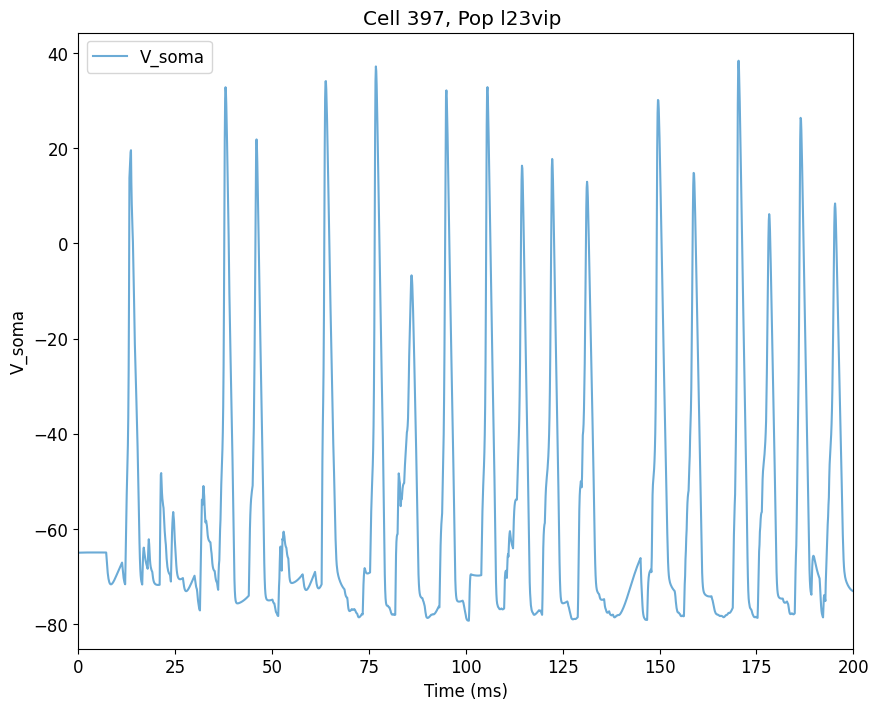

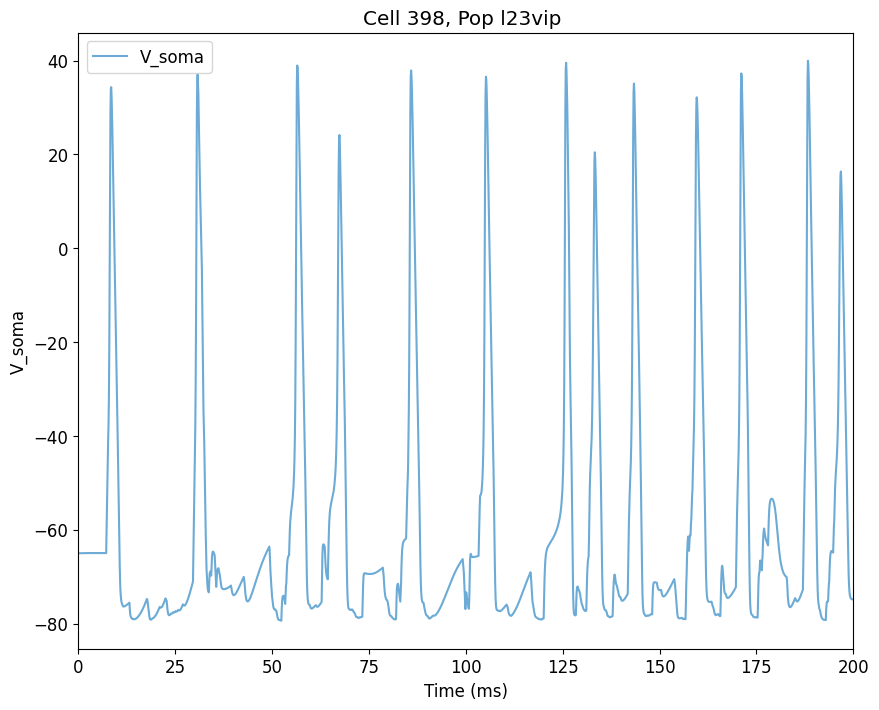

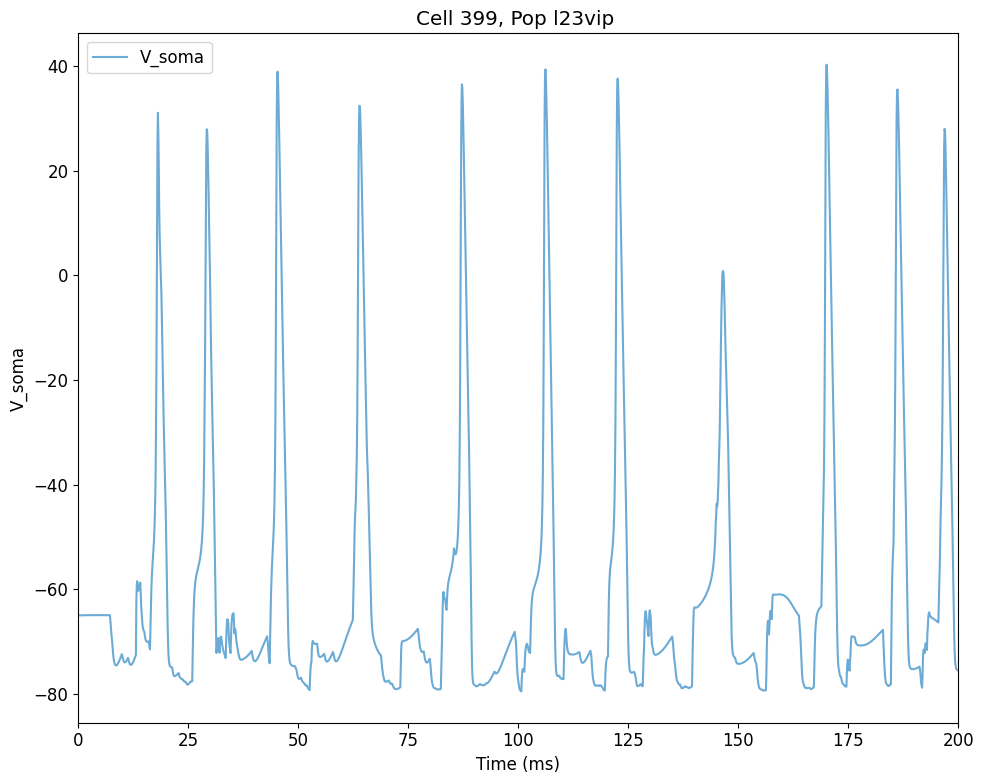

Preparing spike data...
Plotting raster...

There was an exception in plotConn()
Plotting 2D representation of network cell locations and connections...


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/netpyne/analysis/utils.py", line 87, in wrapper
    return function(*args, **kwargs)
TypeError: plotConn() got an unexpected keyword argument 'groupby'


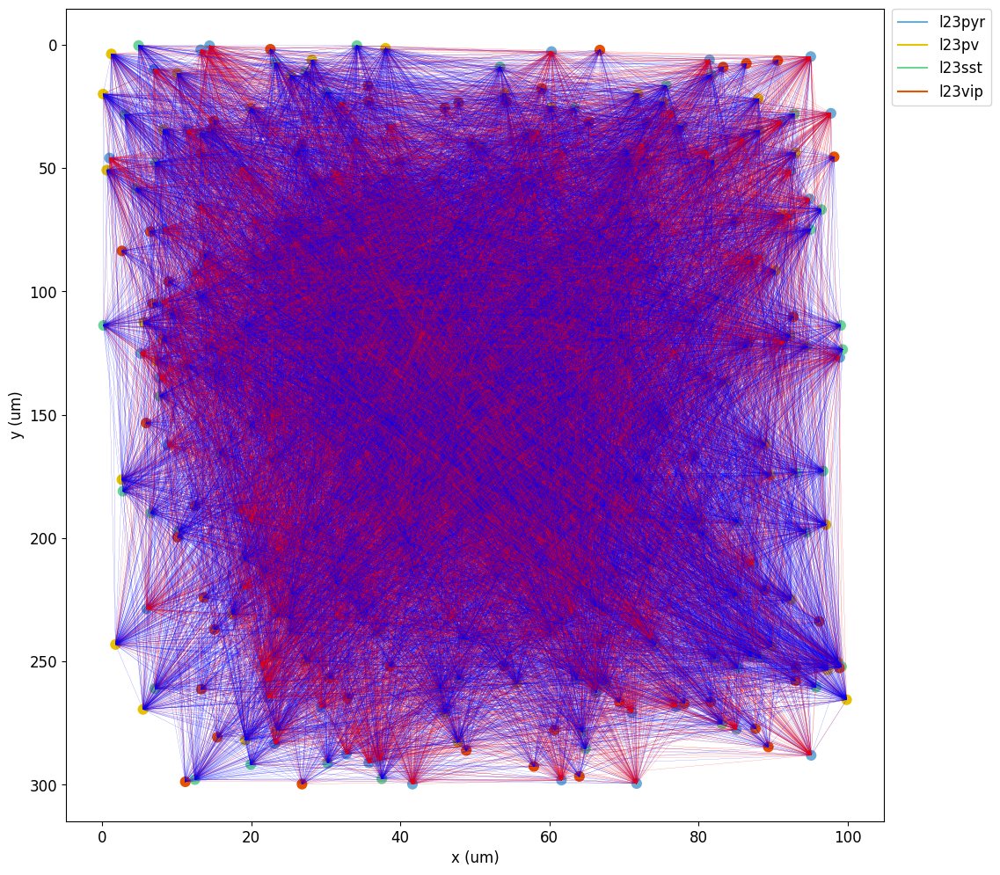

  Done; plotting time = 331.15 s

Total time = 354.43 s


In [ ]:
# ---------------------------------------
sim.createSimulateAnalyze(netParams=netParams, simConfig=simConfig)

Preparing spike data...
Plotting raster...


<Figure size 640x480 with 0 Axes>

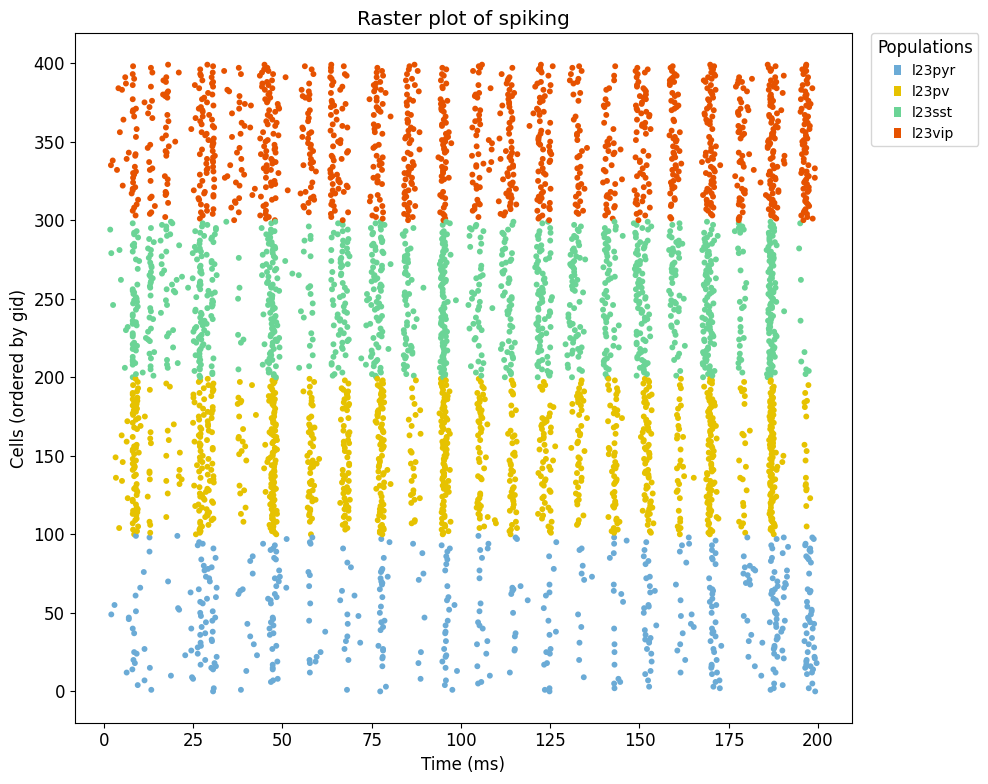

In [ ]:

if sim.allSimData['spkt']:
    plt.figure()
    sim.analysis.plotRaster(
        colors={'l23pyr': 'r', 'l23pv': 'b', 'l23sst': 'g', 'l23vip': 'm'},
        include=populations,
        marker='o',
        markerSize=10,
        showFig=True,
        saveFig=True
    )
else:
    print("No spikes recorded in the simulation.")

# Synaptic kinetics Demo

# Measuring Synaptic Short Term Plasticity

In this notebook we use the [Allen Institute synaptic physiology dataset](https://portal.brain-map.org/explore/connectivity/synaptic-physiology) to measure short term plasticity and its relationship to cell subclass.


In [ ]:
import numpy as np
import scipy.stats
from aisynphys.database import SynphysDatabase
from aisynphys.cell_class import CellClass, classify_pair_dataframe

In [ ]:
# Download and cache the sqlite file for the requested database
#   (for available versions, see SynphysDatabase.list_versions)
db = SynphysDatabase.load_current('small')

# Load all synapses associated with mouse multipatch experiments
pairs = db.pair_query(
    experiment_type='standard multipatch',
    species='mouse',
    synapse=True,
    preload=['cell', 'synapse'],
).dataframe()

print("loaded %d synapses" % len(pairs))

loaded 1805 synapses


## 2. Classify cells

We will pick four simple class defintions for this analysis:

In [ ]:
cell_classes = {
    'pyr': CellClass(cell_class='ex', name='pyr'),
    'pvalb': CellClass(cre_type='pvalb', name='pvalb'),
    'sst': CellClass(cre_type='sst', name='sst'),
    'vip': CellClass(cre_type='vip', name='vip'),
}

In [ ]:
# add new columns to the dataframe that apply the classification defined above
classify_pair_dataframe(cell_classes, pairs, col_names=('pre_class', 'post_class'))

## 3. Calculate average STP metric for each pre/post pairing

In [ ]:
stp = pairs.pivot_table('dynamics.stp_induction_50hz', 'pre_class', 'post_class', aggfunc=np.mean)

# sort rows/cols into the expected order
order = list(cell_classes)
stp = stp[order].loc[order]

stp

post_class,pyr,pvalb,sst,vip
pre_class,,,,
pyr,-0.336121,-0.236252,0.153188,-0.054481
pvalb,-0.498625,-0.475758,-0.347782,-0.263452
sst,-0.125576,-0.133408,-0.168907,0.288444
vip,-0.163041,-0.103669,0.045582,-0.012254


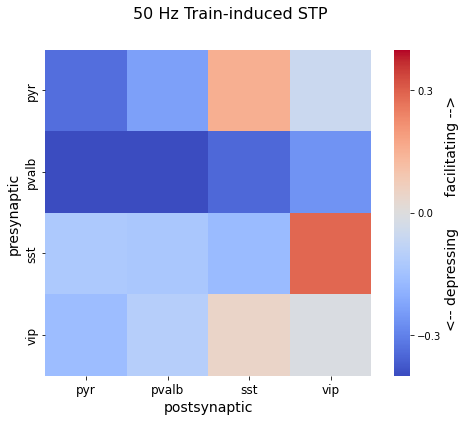

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

fig,ax = plt.subplots(figsize=(8, 6))

hm = sns.heatmap(stp, cmap='coolwarm', vmin=-0.4, vmax=0.4, square=True, ax=ax,
                cbar_kws={"ticks":[-0.3, 0, 0.3], 'label': '<-- depressing       facilitating -->'})

fig.suptitle("50 Hz Train-induced STP", fontsize=16)
hm.set_xlabel("postsynaptic", fontsize=14)
hm.set_ylabel("presynaptic", fontsize=14);
hm.figure.axes[-1].yaxis.label.set_size(14)
hm.tick_params(labelsize=12)

## Alternatively, we can calculate the average resting state variance for each pairing

In [ ]:
var = pairs.pivot_table('dynamics.variability_resting_state', 'pre_class', 'post_class', aggfunc=np.mean)

# sort rows/cols into the expected order
order = list(cell_classes)
var = var[order].loc[order]

var

post_class,pyr,pvalb,sst,vip
pre_class,,,,
pyr,-0.339417,0.490162,1.822031,1.548100
pvalb,-0.833936,-0.919017,-0.719812,-0.142069
sst,-0.230243,-0.159587,0.125349,0.076180
vip,0.539063,0.579907,0.502864,0.271833


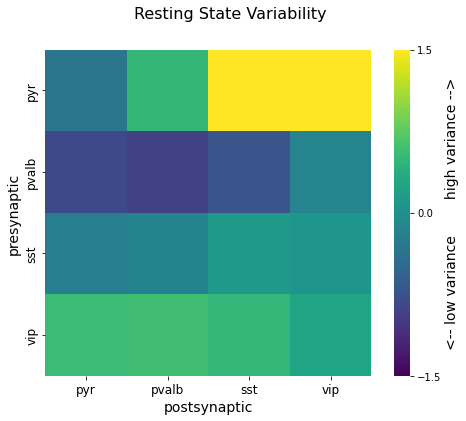

In [ ]:
fig,ax = plt.subplots(figsize=(8, 6))

hm = sns.heatmap(var, cmap='viridis', vmin=-1.5, vmax=1.5, square=True, ax=ax,
                cbar_kws={"ticks":[-1.5, 0, 1.5], 'label': '<-- low variance        high variance -->'})

fig.suptitle("Resting State Variability", fontsize=16)
hm.set_xlabel("postsynaptic", fontsize=14)
hm.set_ylabel("presynaptic", fontsize=14);
hm.figure.axes[-1].yaxis.label.set_size(14)
hm.tick_params(labelsize=12)

## 4. Extract multiple synaptic properties and plot as matrices

Plotting synaptic properties among cell sublcasses in matrices like these is common enough that we have provided a convenince function to do just that called `cell_class_matrix`

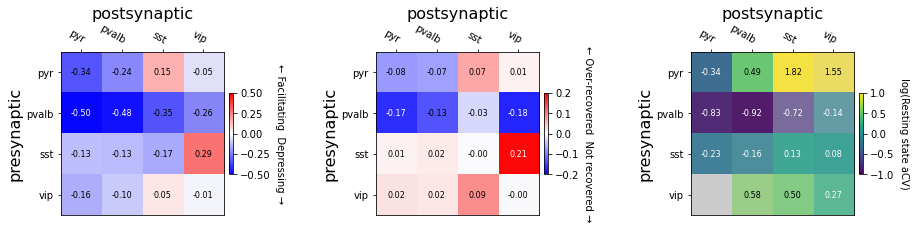

In [ ]:
from aisynphys.ui.notebook import cell_class_matrix

fig,ax = plt.subplots(1, 3, figsize=(16, 3))

metrics = ['stp_induction_50hz', 'stp_recovery_250ms', 'variability_resting_state']

for i, metric in enumerate(metrics):
    cell_class_matrix(
        pre_classes=cell_classes,
        post_classes=cell_classes,
        metric=metric,
        class_labels=None, ax=ax[i],
        db=db, pair_query_args={
            'experiment_type': 'standard multipatch',
            'synapse': True,
            'species': 'mouse',
        }
    );